In [1]:
import torch
import numpy as np
import matplotlib.pyplot as plt
from tqdm import tqdm

In [5]:
import utils

subj = 1

data_path = "/home/juhyeon/fsx/proj-medarc/fmri/natural-scenes-dataset"

train_url = "{" + f"{data_path}/webdataset_avg_split/train/train_subj0{subj}_" + "{0..17}.tar," + f"{data_path}/webdataset_avg_split/val/val_subj0{subj}_0.tar" + "}"
val_url = f"{data_path}/webdataset_avg_split/test/test_subj0{subj}_" + "{0..1}.tar"
print(train_url,"\n",val_url)
meta_url = f"{data_path}/webdataset_avg_split/metadata_subj0{subj}.json"
num_train = 8559 + 300
num_val = 982

print('Prepping train and validation dataloaders...')
train_dl, val_dl, num_train, num_val = utils.get_dataloaders(
    32,
    'images',
    num_devices=torch.cuda.device_count(),
    # num_workers=torch.cuda.device_count() * 4,
    num_workers=1, #FIXME: num_workers=1 for now
    train_url=train_url,
    val_url=val_url,
    meta_url=meta_url,
    num_train=num_train,
    num_val=num_val,
    val_batch_size=1,
    cache_dir=data_path, #"/tmp/wds-cache",
    seed=0,
    voxels_key='nsdgeneral.npy',
    to_tuple=["voxels", "images", "coco"],
    local_rank=0,
    world_size=1,
    subj=subj,
)

{/home/juhyeon/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/train/train_subj01_{0..17}.tar,/home/juhyeon/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/val/val_subj01_0.tar} 
 /home/juhyeon/fsx/proj-medarc/fmri/natural-scenes-dataset/webdataset_avg_split/test/test_subj01_{0..1}.tar
Prepping train and validation dataloaders...
Getting dataloaders...
in utils.py: num_devices: 4

num_train 8859
global_batch_size 128
batch_size 32
num_workers 1
num_batches 69
num_worker_batches 69

num_val 982
val_num_batches 7
val_batch_size 1


In [14]:
train_dl.dataset.__len__()

AttributeError: 'WebDataset' object has no attribute '__len__'

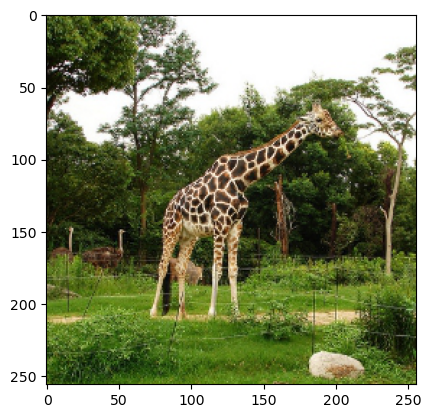

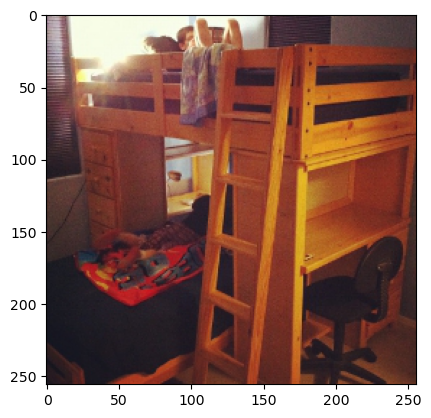

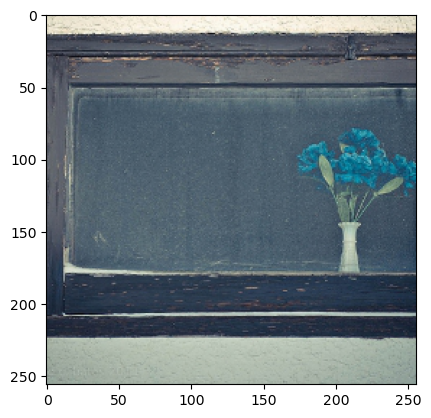

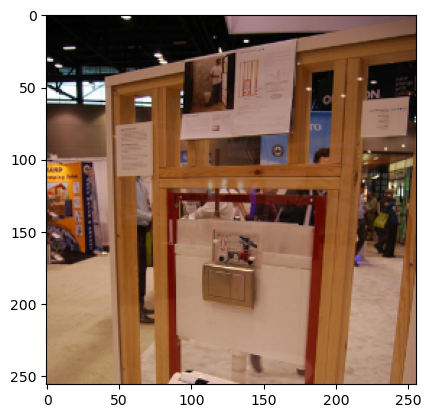

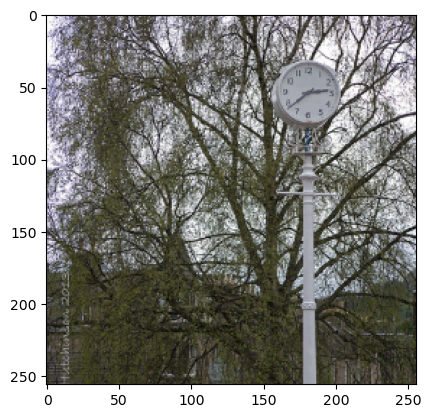

...

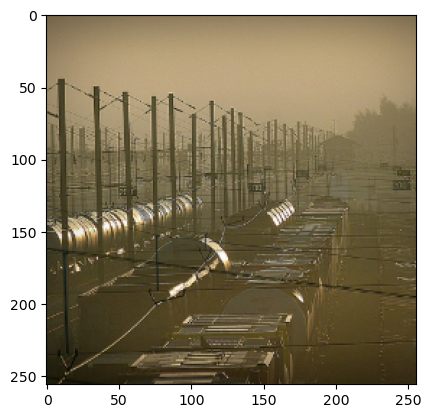

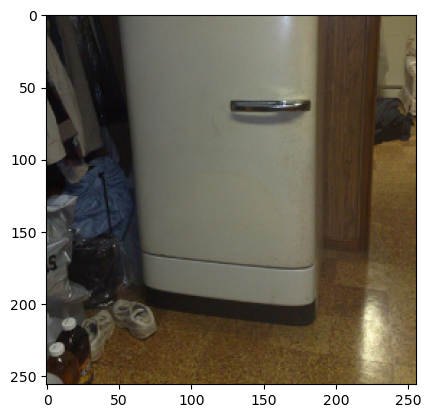

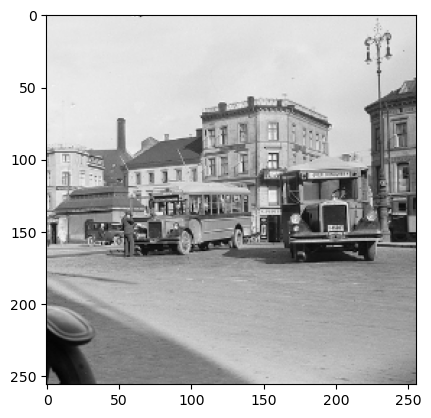

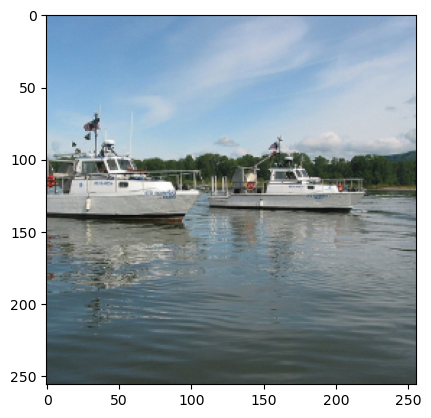

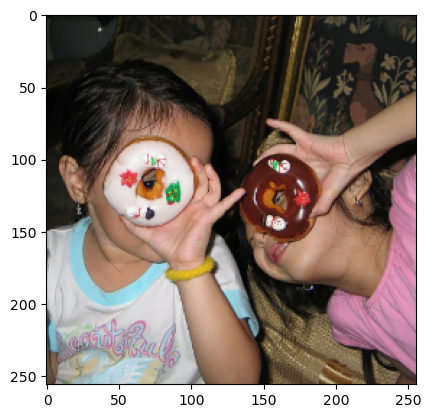

In [11]:
# for train_i, (voxel, image, coco) in enumerate(train_dl):
    